In [1]:
import fiona
import pandas as pd
import geopandas
import os
import geopandas as gpd

In [11]:
os.chdir('/Users/jarvis/Desktop/CE 88/SoCalEVCSNetwork')

In [50]:
census_tracts = gpd.read_file(r'data/socal_acs.geojson')

In [51]:
census_tracts.crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World - 85°S to 85°N
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

<AxesSubplot:>

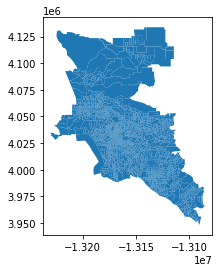

In [52]:
census_tracts.plot()

In [35]:
socal_zipcodes = gpd.read_file(r'data/socal_zipcodes/socal_zip.shp')

In [36]:
socal_zipcodes.head(1)

,STATEFP10,ZCTA5CE10,GEOID10,CLASSFP10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,PARTFLG10,geometry
0,06,91504,0691504,B5,G6350,S,12783282,29685,+34.2045683,-118.3263651,N,"POLYGON ((-118.34858 34.20846, -118.34856 34.2..."


In [37]:
socal_zipcodes.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - NAD83
- bounds: (167.65, 14.92, -47.74, 86.46)
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

<AxesSubplot:>

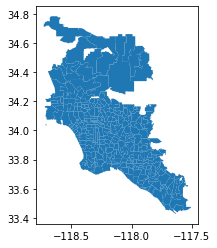

In [38]:
socal_zipcodes.plot()

In [39]:
socal_zipcodes = socal_zipcodes.to_crs(epsg=3857)
socal_zipcodes.crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World - 85°S to 85°N
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

<AxesSubplot:>

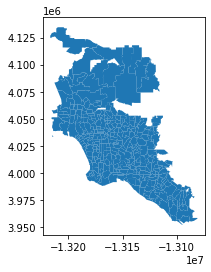

In [53]:
socal_zipcodes.plot()

<AxesSubplot:>

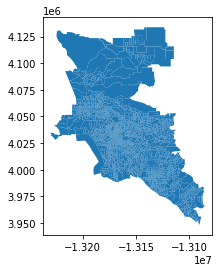

In [54]:
census_tracts.plot()
# axis should be in the same emm, scale

In [55]:
census_tracts['centroid'] = census_tracts.centroid
census_tracts_centroid = census_tracts.drop('geometry', axis=1)
census_tracts_centroid = gpd.GeoDataFrame(census_tracts_centroid, geometry='centroid')
census_tracts_centroid.head()

,GEOID,total_hispanic,median_age,total_pop,total_pop_white,total_pop_black,total_pop_asian,30-34_min,45-49_min,agg_travel_time,...,avg_travel_time,pct_white,pct_black,pct_asian,pct_hispanic,pct_bachelor,pct_access_to_veh,pct_30-34_min,pct_45-49_min,centroid
0,06037670403,116.0,49.5,2733.0,1483.0,26.0,1068.0,78.0,108.0,36700.0,...,38.835979,54.262715,0.951336,39.077936,4.244420,0.036590,34.577387,2.854007,3.951701,POINT (-13176709.461 3998651.935)
1,06037670202,481.0,48.6,2637.0,1790.0,25.0,534.0,133.0,108.0,30040.0,...,35.976048,67.880167,0.948047,20.250284,18.240425,0.000000,31.664771,5.043610,4.095563,POINT (-13175540.654 4000448.836)
2,06037670701,1841.0,46.9,7185.0,4346.0,43.0,1333.0,417.0,184.0,99705.0,...,36.588991,60.487126,0.598469,18.552540,25.622825,0.389701,37.926235,5.803758,2.560891,POINT (-13170545.675 3996905.858)
3,06037293307,1384.0,36.1,2284.0,703.0,234.0,396.0,165.0,102.0,33015.0,...,32.850746,30.779335,10.245184,17.338004,60.595447,0.394046,44.001751,7.224168,4.465849,POINT (-13169491.228 4000287.575)
4,06037296300,1171.0,42.7,5027.0,2713.0,458.0,1253.0,366.0,294.0,74600.0,...,36.839506,53.968570,9.110802,24.925403,23.294211,0.696240,40.282475,7.280684,5.848419,POINT (-13169237.628 3995896.673)


In [56]:
type(census_tracts_centroid)

geopandas.geodataframe.GeoDataFrame

In [57]:
census_tracts_centroid.crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World - 85°S to 85°N
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

<AxesSubplot:>

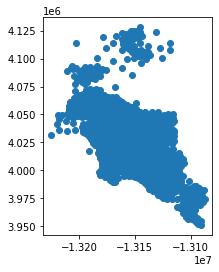

In [58]:
census_tracts_centroid.plot()

<AxesSubplot:>

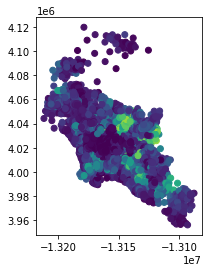

In [61]:
zip_census_tracts_centroid = gpd.sjoin(census_tracts_centroid, socal_zipcodes, how='inner', op='within')
zip_census_tracts_centroid.plot('pct_asian')

In [63]:
zip_census_tracts_centroid.head()

,GEOID,total_hispanic,median_age,total_pop,total_pop_white,total_pop_black,total_pop_asian,30-34_min,45-49_min,agg_travel_time,...,ZCTA5CE10,GEOID10,CLASSFP10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,PARTFLG10
0,06037670403,116.0,49.5,2733.0,1483.0,26.0,1068.0,78.0,108.0,36700.0,...,90275,0690275,B5,G6350,S,35004660,8398187,+33.7531460,-118.3674589,N
2,06037670701,1841.0,46.9,7185.0,4346.0,43.0,1333.0,417.0,184.0,99705.0,...,90275,0690275,B5,G6350,S,35004660,8398187,+33.7531460,-118.3674589,N
589,06037670407,565.0,44.4,6269.0,2118.0,193.0,3274.0,236.0,337.0,100640.0,...,90275,0690275,B5,G6350,S,35004660,8398187,+33.7531460,-118.3674589,N
865,06037670411,214.0,49.6,4356.0,2840.0,79.0,1037.0,177.0,182.0,52325.0,...,90275,0690275,B5,G6350,S,35004660,8398187,+33.7531460,-118.3674589,N
1142,06037670413,346.0,51.9,4433.0,2180.0,51.0,2084.0,226.0,249.0,57330.0,...,90275,0690275,B5,G6350,S,35004660,8398187,+33.7531460,-118.3674589,N


In [62]:
zip_census_tracts_centroid.to_file("data/socal_acs_tract_on_zipcode.geojson", driver='GeoJSON')